# **Chaos Fusion: Interaction of Two Different Chaotic Systems**


```
Copyright (c) 2023, Informatics and Information Security Research Center @ TUBITAK
SPDX-License-Identifier: Apache-2.0
```

|Name|Affiliation|IEEE Member|SSCS Member|
|:--:|:----------:|:----------:|:----------:|
|Onur Karataş  <br />  Email: onur.karatas@tubitak.gov.tr|TUBITAK BILGEM, TURKEY|No|No|

## **Project Description**
---
This research delves into the development of a novel chaotic system arising from the interaction of two distinct chaotic systems. The dynamic attributes of the resultant chaotic system have been meticulously examined through Logistic Map bifurcation analysis. Furthermore, it underwent rigorous testing employing the NIST SP 800-22 randomness test suite. These analyses and evaluations aim to scrutinize the systems' competence in generating random data, providing pivotal insights into their dependability and the extent of randomness they exhibit. The chaotic systems utilized in this study are articulated as follows:

 - Double Scroll Chaos 3rd Order ODE Equation [1]:
\begin{align}
\dot{x} &= y \nonumber\\
\dot{y} &= z \nonumber\\
\dot{z} &= -a(f(x)+y+z) \nonumber
\end{align}

 - Rössler Chaos 3rd Order ODE Equation [2]:
\begin{align}
\dot{u} &= v \nonumber\\
\dot{v} &= w \nonumber\\
\dot{w} &= -w-v*B(v)-u \nonumber
\end{align}

The Digital Double Scroll and Rössler chaotic systems, resolved within a digital milieu employing the Euler approach, have been interacted to engender a novel system. This emerging system manifests chaotic behavior.

 - Interacted Euler Approximation:
\begin{align}
x_{t+h} = u_t +h[\dot{u_t}] \nonumber\\
y_{t+h} = v_t +h[\dot{v_t}] \nonumber\\
z_{t+h} = w_t +h[\dot{w_t}] \nonumber\\
u_{t+h} = x_t +h[\dot{x_t}] \nonumber\\
v_{t+h} = y_t +h[\dot{y_t}] \nonumber\\
w_{t+h} = z_t +h[\dot{z_t}] \nonumber
\end{align}

The findings acquired present novel avenues to comprehend the intricate nature of chaotic systems, explore their interrelations, and delve into potential applications across diverse fields.
<br><br>
Additionally, the Double Scroll and Rössler chaotic systems have been granted production rights within the Efabless MPW5 and MPW6 programs.

- Efabless MPW-6: [RNG MULTI SCROLL CHAOS](https://platform.efabless.com/projects/973)

- Efabless MPW-5: [RNG CHAOS](https://platform.efabless.com/projects/793)

### **References**
---
- [1] O. Karataş and S. Ergün, "A Digital Random Number Generator Based on Regular Sampling of Double Scroll Chaos," 2021 IEEE Asia Pacific Conference on Circuit and Systems (APCCAS), Penang, Malaysia, 2021, pp. 101-104, doi: 10.1109/APCCAS51387.2021.9687811.

- [2] M. A. Zidan, A. G. Radwan and K. N. Salama, "Random number generation based on digital differential chaos," 2011 IEEE 54th International Midwest Symposium on Circuits and Systems (MWSCAS), Seoul, Korea (South), 2011, pp. 1-4, doi: 10.1109/MWSCAS.2011.6026266.

### **Tools version**
---
- openlane version : 2023.11.03_0_gf4f8dad8
- open_pdks.sky130a version: 1.0.456_0_g2a38e86


In [1]:
#@title Install dependencies {display-mode: "form"}

import os
import pathlib

!curl -Ls https://micro.mamba.pm/api/micromamba/linux-64/latest | tar -xj bin/micromamba
conda_prefix_path = pathlib.Path('conda-env')
CONDA_PREFIX = str(conda_prefix_path.resolve())
!bin/micromamba create --yes --prefix $CONDA_PREFIX
!echo 'python ==3.7*' >> {CONDA_PREFIX}/conda-meta/pinned
!CI=0 bin/micromamba install --yes --prefix $CONDA_PREFIX \
                     --channel litex-hub \
                     --channel main \
                     numpy \
                     iverilog \
                     openlane='2023.11.03_0_gf4f8dad8'  \
                     open_pdks.sky130a='1.0.456_0_g2a38e86 '

!python -m pip install libparse gdstk

PATH = os.environ['PATH']
%env CONDA_PREFIX={CONDA_PREFIX}
%env PATH={CONDA_PREFIX}/bin:{PATH}

!git clone https://github.com/dj-on-github/sp800_22_tests.git

Empty environment created at prefix: /content/conda-env

Pinned packages:
  - python 3.7*


Transaction

  Prefix: /content/conda-env

  Updating specs:

   - numpy
   - iverilog
   - openlane=2023.11.03_0_gf4f8dad8
   - open_pdks.sky130a=1.0.456_0_g2a38e86


  Package                                                Version  Build                 Channel        Size
─────────────────────────────────────────────────────────────────────────────────────────────────────────────
  Install:
─────────────────────────────────────────────────────────────────────────────────────────────────────────────

  + open_pdks.sky130a                         1.0.456_0_g2a38e86  20231104_052339       litex-hub       1GB
  + blas                                                     1.0  mkl                   main            6kB
  + _libgcc_mutex                                            0.1  main                  main            3kB
  + libstdcxx-ng                                          11.2.0  h1234567_1

## RTL Design & Simulation

In RTL design, a multitude of parameters exists, allowing for the acquisition of diverse chaotic structures by manipulating and fine-tuning these variables. Comprehensive data has been gathered through simulations to analyze and test the generated chaotic systems.

In [2]:
#@title Write SystemVerilog RTL {display-mode: "form"}
%%writefile chaos.sv
module chaos(
`ifdef USE_POWER_PINS
    inout vccd1,  // User area 1 1.8V supply
    inout vssd1,	  // User area 1 digital ground
`endif
	input clk_i,
	input rst_ni,
	input [ 3:0] en,
	input [ 3:0] Lx,
	input [ 2:0] Ux,
	input [ 3:0] Ly,
	input [ 2:0] Uy,
	input [ 3:0] Lz,
	input [ 2:0] Uz,
	output logic [31:0] x,
	output logic [31:0] y,
	output logic [31:0] z,
  output logic [31:0] u,
	output logic [31:0] v,
	output logic [31:0] w
);

// wires
logic [31:0] Fx, xn, xo, un;
logic [31:0] Fy, yn, yo, vn;
logic [31:0] Fz, zn, zo, zd, zd1, zd2, wn;



func Fx_func(
    .F_i(x),
    .U_i(Ux),
    .L_i(Lx),
    .F_o(Fx)
    );

assign xo = en[1] ? Fx : x;

func Fy_func(
    .F_i(y),
    .U_i(Uy),
    .L_i(Ly),
    .F_o(Fy)
    );

assign yo = en[2] ? Fy : y;

func Fz_func(
    .F_i(z),
    .U_i(Uz),
    .L_i(Lz),
    .F_o(Fz)
    );

assign zo = en[3] ? Fz : z;

assign zd1 = xo+yo+zo;
assign zd2 = {{4{ zd1[31]}},  zd1[31:4]};
assign zd =   zd1 - zd2;

assign xn = x + {{3{yo[31]}}, yo[31:3]};
assign yn = y + {{3{zo[31]}}, zo[31:3]};
assign zn = z - {{3{zd[31]}}, zd[31:3]};

//---------------------------------------------//

logic sen;
logic [31:0] by;
logic [31:0] zy;

assign sen = (~v[31])  &  (|v[30:22]);

assign by = ({32{sen}})  &  ({v[29:0],2'b0});

assign zy = w+u+by;

assign un = u + {{6{ v[31]}},  v[31:6]};
assign vn = v + {{6{ w[31]}},  w[31:6]};
assign wn = w - {{6{ zy[31]}}, zy[31:6]};

/* verilator lint_off UNUSEDSIGNAL */
logic [2:0] zd_not_used;
logic [5:0] zy_not_used;

assign zd_not_used = zd[2:0];
assign zy_not_used = zy[5:0];

always @(posedge clk_i)
begin
	if(!rst_ni) begin
    x  <= 32'hDE78D681;
    y  <= 32'hFEEE4640;
    z  <= 32'hFE8E511B;
    u <= 32'h0;
    v <= {{9{1'b0}}, 1'b1, {22{1'b0}}};
    w <= 32'h0;
	end else if (en[0]) begin
		x <= un;
		y <= vn;
		z <= wn;
    u <= xn;
		v <= yn;
		w <= zn;
  end else begin
		x <= xn;
		y <= yn;
		z <= zn;
    u <= un;
		v <= vn;
		w <= wn;
	end
end

endmodule

module func(
    input        [31:0] F_i,
    input        [ 2:0] U_i,
    input        [ 3:0] L_i,
    output logic [31:0] F_o
    );

 logic [ 5:0] Xhigh;
 logic [ 5:0] X26_6n;
 logic [ 5:0] Se_U;
 logic [ 5:0] XU;
 logic [ 5:0] XU_X26;
 logic [ 5:0] out_6b;

  assign Xhigh  = F_i[31:26] - {L_i[3],L_i,1'b1};
  assign X26_6n = ~{6{F_i[26]}};
  assign Se_U   = {U_i[2],U_i[2],U_i,1'b1};
  assign XU     = F_i[31:26] - Se_U;
  assign XU_X26 = (XU[5]) ? X26_6n : XU;
  assign out_6b = (Xhigh[5]) ?  Xhigh : XU_X26;
  assign F_o = {out_6b, F_i[25:0]};

endmodule


Writing chaos.sv


In [3]:
#@title Write SystemVerilog TB {display-mode: "form"}
%%writefile tb_chaos.sv
// Testbench
module tb_chaos;

	logic clk_i;
  logic rst_ni;
	logic [ 3:0] en;
	logic [ 3:0] Lx;
	logic [ 2:0] Ux;
	logic [ 3:0] Ly;
	logic [ 2:0] Uy;
	logic [ 3:0] Lz;
	logic [ 2:0] Uz;
	logic [31:0] x;
	logic [31:0] y;
	logic [31:0] z;
  logic [31:0] u;
	logic [31:0] v;
	logic [31:0] w;

  integer file_separated;
  integer file_combined;
  integer file_data;

  chaos uut(
	  .clk_i  (clk_i ),
	  .rst_ni (rst_ni),
	  .en     (en    ),
	  .Lx     (Lx    ),
	  .Ux     (Ux    ),
	  .Ly     (Ly    ),
	  .Uy     (Uy    ),
	  .Lz     (Lz    ),
	  .Uz     (Uz    ),
	  .x      (x     ),
	  .y      (y     ),
	  .z      (z     ),
    .u      (u   ),
	  .v      (v    ),
	  .w      (w    )
  );

  always begin
    #5 clk_i <= ~clk_i;
  end

  initial begin
    clk_i  = 0;
    rst_ni = 0;
    en     = 0;
    Lx     = 0;
    Ux     = 0;
    Ly     = 0;
    Uy     = 0;
    Lz     = 0;
    Uz     = 0;

    #100

    // Separated System Data
    rst_ni = 1;
    Lx = 4'b1011;
    Ux = 3'b100;
    en = 4'b0010;
    #5000
    file_separated = $fopen("separated.csv", "w");
      repeat(10000)begin #10 $fdisplay(file_separated, "%d, %d, %d, %d, %d, %d", $signed(x), $signed(y), $signed(z), $signed(u), $signed(v), $signed(w)); end
    $fclose(file_separated);

    // Compbined System Data
    rst_ni = 0; #10 rst_ni = 1;
    en = 4'b0011;
    #5000
    file_combined = $fopen("combined.csv", "w");
      repeat(10000)begin #10 $fdisplay(file_combined, "%d, %d, %d, %d, %d, %d", $signed(x), $signed(y), $signed(z), $signed(u), $signed(v), $signed(w)); end
    $fclose(file_combined);

    // Bifurcation analysis and NIST testing is performed on the x[17] bit.
    file_data = $fopen("data.txt", "wb");
      repeat(1048576)begin #10 $fdisplay(file_data, "%b", x[17]); end
    $fclose(file_data);

    $finish;
  end

endmodule


Writing tb_chaos.sv


In [4]:
#@title Run Simulation & Collect Data {display-mode: "form"}
!iverilog -g2005-sv -o  my_design.vvp chaos.sv tb_chaos.sv
!vvp my_design.vvp

with open('data.txt', 'r') as text_file:
    binary_content = ''.join(text_file.read().split())

with open('data.bin', 'wb') as binary_file:
    binary_file.write(bytes([int(binary_content[i:i+8], 2) for i in range(0, len(binary_content), 8)]))

tb_chaos.sv:82: $finish called at 10695870 (1s)


## Analyses and Tests

The data collected from the suggested chaotic systems were gathered through simulations and subsequently plotted to illustrate the resulting chaotic system. Upon examination of the plots, it becomes apparent that the new chaotic system displays characteristics originating from both of these systems.

Bifurcation analysis is a methodology utilized to comprehend various behavioral patterns within a dynamic system and to discern whether the system exhibits chaotic or regular traits. The Logistic Map bifurcation analysis allows observation and analysis of alterations occurring within a system by altering specific parameters. This analytical approach provides significant insights into understanding the complexity, chaotic behaviors, and regions of stability within the system. Such analyses are extensively employed in comprehending and analyzing the intricacies of systems.

NIST (National Institute of Standards and Technology) is an organization that establishes standards, develops tests and guidelines, and conducts research on topics such as information technology, security, and data accuracy. Specifically, the NIST SP-800-22 tests comprise a series of statistical tests and methods designed to assess the reliability and randomness levels of random number generators or cryptographic algorithms. These tests have been observed to be successful up to the least significant 17 bits. This observation indicates that the design can achieve a throughput of up to approximately 10 Gbps while operating at 100 MHz.


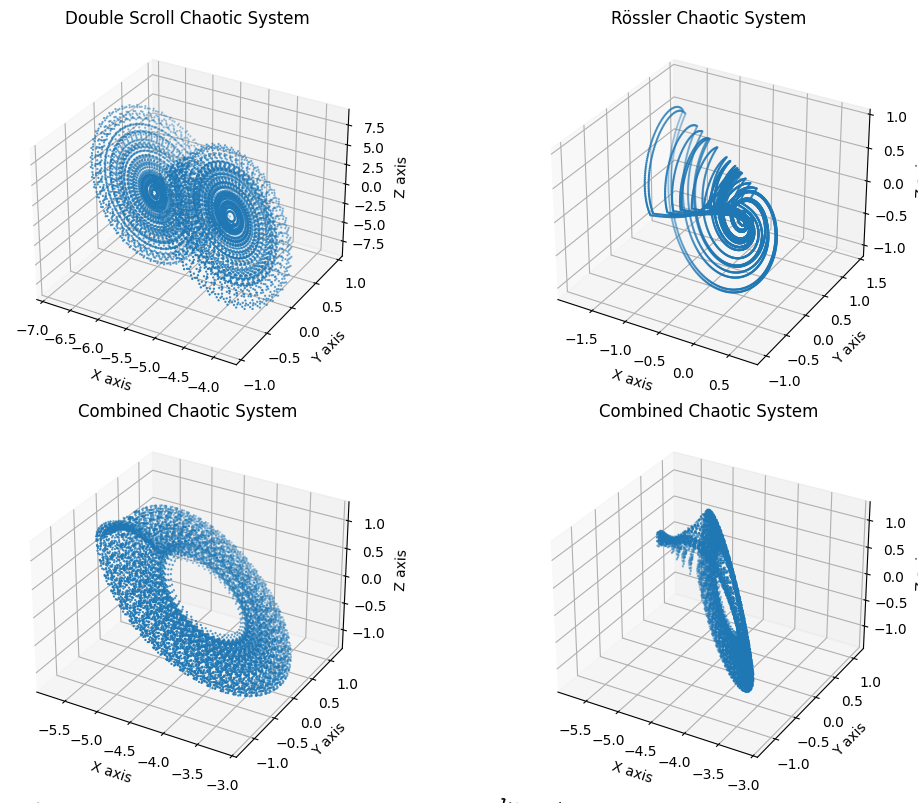

In [5]:
#@title Plot Chaos Attractors {display-mode: "form"}
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

def plot_chaos(file_name, columns, subplot_number):
    df = pd.read_csv(file_name)
    x = df.iloc[:, columns[0]]
    y = df.iloc[:, columns[1]]
    z = df.iloc[:, columns[2]]

    ax = fig.add_subplot(subplot_number, projection='3d')
    ax.scatter(x, y, z, s=0.4)
    ax.set_xlabel('X axis')
    ax.set_ylabel('Y axis')
    ax.set_zlabel('Z axis')

    return ax

fig = plt.figure(figsize=(12, 8))


ax1 = plot_chaos("separated.csv", [0, 1, 2], 221)
ax1.set_title('Double Scroll Chaotic System')

ax2 = plot_chaos("separated.csv", [3, 5, 4], 222)
ax2.set_title('Rössler Chaotic System')

ax3 = plot_chaos("combined.csv",  [0, 1, 2], 223)
ax3.set_title('Combined Chaotic System')

ax4 = plot_chaos("combined.csv",  [3, 5, 4], 224)
ax4.set_title('Combined Chaotic System')

plt.tight_layout()
plt.show()



In [6]:
#@title Listen to the Sound of Chaos {display-mode: "form"}

import numpy as np
from scipy.io.wavfile import write
from IPython.display import Audio, display

# Generating frequency and duration values by manipulating random ones from the file
def get_random_values():
    with open('data.bin', 'rb') as file:
        data = file.read()

    # Generating frequency and duration values by taking a random bit from each byte
    frequency = 27.5 + 4158.5 * np.frombuffer(data, dtype=np.uint8) / 255.0
    duration = 0.1 + 0.4 * np.frombuffer(data, dtype=np.uint8) / 255.0

    return frequency, duration

# Sample parameters
note_count = 200  # Number of notes to be generated
sampling_rate = 44100  # Sampling frequency
duration = 10  # Total music duration (seconds)
music_length = int(sampling_rate * duration)

# Creating an empty array for music
music = np.zeros(music_length)

# Extracting frequency and duration values by manipulating random ones from the file
note_frequencies, note_durations = get_random_values()

# Generating piano-like notes
for i in range(note_count):
    note_duration = note_durations[i % len(note_durations)]  # Fetching the duration value
    note_frequency = note_frequencies[i % len(note_frequencies)]  # Fetching the frequency value

    # Calculating the start and end indices of the notes
    note_start = np.random.randint(0, music_length - int(sampling_rate * note_duration))
    note_end = int(note_start + sampling_rate * note_duration)

    # Generating a sinusoidal wave and adding the note to the music array
    t = np.linspace(0, note_duration, int(sampling_rate * note_duration), endpoint=False)
    note_wave = np.sin(2 * np.pi * note_frequency * t)
    music[note_start:note_end] += note_wave

# Normalizing the music
music = music / np.max(np.abs(music))

# Saving the generated music as a sound file
write('random_piano_notes.wav', sampling_rate, np.int16(music * 32767))
display(Audio('random_piano_notes.wav', autoplay=True))

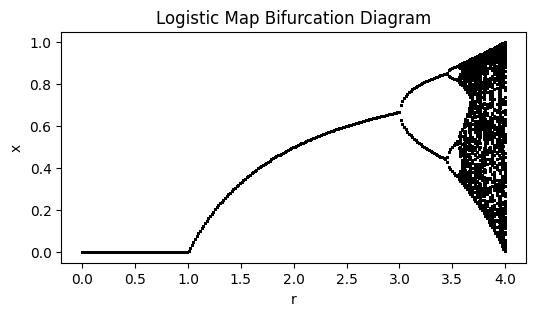

In [7]:
#@title Run Logistic Map Bifurcation Analisis {display-mode: "form"}
import struct
import matplotlib.pyplot as plt

def logistic_map(r, x):
    return r * x * (1 - x)

def bifurcation_diagram(data, generations):
    r_values = []
    x_values = []

    for byte in data:
        r = byte / 255 * 4  # To convert values in the range 0-255 to the range 0-4
        x = 0.2  # initial value
        for _ in range(generations):
            x = logistic_map(r, x)
            if generations - _ > 100:  # The first 100 generations to skip
                continue
            r_values.append(r)
            x_values.append(x)

    plt.figure(figsize=(6, 3))
    plt.scatter(r_values, x_values, s=0.1, c='black', alpha=0.5)
    plt.xlabel('r')
    plt.ylabel('x')
    plt.title('Logistic Map Bifurcation Diagram')
    plt.show()

with open('data.bin', 'rb') as file:
    byte_data = file.read()

bifurcation_diagram(byte_data, 1000)  # for 1000 generations


In [8]:
#@title Run NIST SP-800-22 Test Suite {display-mode: "form"}
!python  /content/sp800_22_tests/sp800_22_tests.py data.bin

Tests of Distinguishability from Random
TEST: monobit_test
  Ones count   = 524099
  Zeroes count = 524477
  PASS
  P=0.712022909555208
TEST: frequency_within_block_test
  n = 1048576
  N = 99
  M = 10591
  PASS
  P=0.8125038348525367
TEST: runs_test
  prop  0.4998197555541992
  tau  0.001953125
  vobs  524785.0
  PASS
  P=0.33162979195316167
TEST: longest_run_ones_in_a_block_test
  n = 1048576
  K = 6
  M = 10000
  N = 75
  chi_sq = 7.336790723746446
  PASS
  P=0.29082053598622
TEST: binary_matrix_rank_test
  Number of blocks 1024
  Data bits used: 1048576
  Data bits discarded: 0
  Full Rank Count  =  292
  Full Rank -1 Count =  593
  Remainder Count =  139
  Chi-Square =  0.08489683142008335
  PASS
  P=0.9584399046877449
TEST: dft_test
  N0 = 498073.600000
  N1 = 497986.000000
  PASS
  P=0.43243482776734943
TEST: non_overlapping_template_matching_test
  PASS
  P=1.0000097824566938
TEST: overlapping_template_matching_test
  B =  [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
  m =  10
  M =  1062
  

## RTL to GDSII Flow

[OpenLane](https://openlane.readthedocs.io/en/latest/) is an automated [RTL](https://en.wikipedia.org/wiki/Register-transfer_level) to [GDSII](https://en.wikipedia.org/wiki/GDSII) flow based on several components including [OpenROAD](https://theopenroadproject.org/), [Yosys](https://yosyshq.net/yosys/), [Magic](http://www.opencircuitdesign.com/magic/), [Netgen](http://opencircuitdesign.com/netgen/) and custom methodology scripts for design exploration and optimization targeting [open source PDKs](https://github.com/google/open-source-pdks).

![img](https://openlane.readthedocs.io/en/latest/_images/flow_v1.png)

In [9]:
#@title Write SDC {display-mode: "form"}
%%writefile /content/chaos.sdc
if {[info exists ::env(CLOCK_PORT)] && $::env(CLOCK_PORT) != ""} {
    create_clock [get_ports $::env(CLOCK_PORT)]  -name $::env(CLOCK_PORT)  -period $::env(CLOCK_PERIOD)
} else {
    create_clock -name __VIRTUAL_CLK__ -period $::env(CLOCK_PERIOD)
    set ::env(CLOCK_PORT) __VIRTUAL_CLK__
}

set input_delay_value [expr $::env(CLOCK_PERIOD) * $::env(IO_PCT)]
set output_delay_value [expr $::env(CLOCK_PERIOD) * $::env(IO_PCT)]
puts "\[INFO\]: Setting output delay to: $output_delay_value"
puts "\[INFO\]: Setting input delay to: $input_delay_value"

set_max_fanout $::env(MAX_FANOUT_CONSTRAINT) [current_design]
if { [info exists ::env(MAX_TRANSITION_CONSTRAINT)] } {
    set_max_transition $::env(MAX_TRANSITION_CONSTRAINT) [current_design]
}

set clk_input [get_port $::env(CLOCK_PORT)]
set clk_indx [lsearch [all_inputs] $clk_input]
set all_inputs_wo_clk [lreplace [all_inputs] $clk_indx $clk_indx ""]

#set rst_input [get_port resetn]
#set rst_indx [lsearch [all_inputs] $rst_input]
#set all_inputs_wo_clk_rst [lreplace $all_inputs_wo_clk $rst_indx $rst_indx ""]
set all_inputs_wo_clk_rst $all_inputs_wo_clk

# correct resetn
set_input_delay $input_delay_value  -clock [get_clocks $::env(CLOCK_PORT)] $all_inputs_wo_clk_rst
#set_input_delay 0.0 -clock [get_clocks $::env(CLOCK_PORT)] {resetn}
set_output_delay $output_delay_value  -clock [get_clocks $::env(CLOCK_PORT)] [all_outputs]

if { ![info exists ::env(SYNTH_CLK_DRIVING_CELL)] } {
    set ::env(SYNTH_CLK_DRIVING_CELL) $::env(SYNTH_DRIVING_CELL)
}

if { ![info exists ::env(SYNTH_CLK_DRIVING_CELL_PIN)] } {
    set ::env(SYNTH_CLK_DRIVING_CELL_PIN) $::env(SYNTH_DRIVING_CELL_PIN)
}

set_driving_cell -lib_cell $::env(SYNTH_DRIVING_CELL) -pin $::env(SYNTH_DRIVING_CELL_PIN) $all_inputs_wo_clk_rst
set_driving_cell -lib_cell $::env(SYNTH_CLK_DRIVING_CELL) -pin $::env(SYNTH_CLK_DRIVING_CELL_PIN) $clk_input

# fF -> pF
set cap_load [expr $::env(OUTPUT_CAP_LOAD) / 1000.0]
puts "\[INFO\]: Setting load to: $cap_load"
set_load  $cap_load [all_outputs]

puts "\[INFO\]: Setting clock uncertainty to: $::env(SYNTH_CLOCK_UNCERTAINTY)"
set_clock_uncertainty $::env(SYNTH_CLOCK_UNCERTAINTY) [get_clocks $::env(CLOCK_PORT)]

puts "\[INFO\]: Setting clock transition to: $::env(SYNTH_CLOCK_TRANSITION)"
set_clock_transition $::env(SYNTH_CLOCK_TRANSITION) [get_clocks $::env(CLOCK_PORT)]

puts "\[INFO\]: Setting timing derate to: [expr {$::env(SYNTH_TIMING_DERATE) * 100}] %"
set_timing_derate -early [expr {1-$::env(SYNTH_TIMING_DERATE)}]
set_timing_derate -late [expr {1+$::env(SYNTH_TIMING_DERATE)}]

Writing /content/chaos.sdc


In [10]:
#@title Write Config {display-mode: "form"}
%%writefile /content/config.json
{
    "DESIGN_NAME": "chaos",
    "VERILOG_FILES": "chaos.sv",
    "CLOCK_PERIOD": 10,
    "CLOCK_NET": "chaos.clk_i",
    "CLOCK_PORT": "clk_i",

    "BASE_SDC_FILE": "chaos.sdc",

    "SYNTH_STRATEGY": "DELAY 0",
    "SYNTH_FLAT_TOP": 1,
    "SYNTH_CLOCK_UNCERTAINTY": 0.08,
    "SYNTH_BUFFERING": 0,
    "MAX_TRANSITION_CONSTRAINT": 1.0,
    "MAX_FANOUT_CONSTRAINT": 128,
    "SYNTH_USE_PG_PINS_DEFINES": "USE_POWER_PINS",
    "VDD_NETS": "vccd1",
    "GND_NETS": "vssd1",

    "DESIGN_IS_CORE": 1,
    "FP_SIZING": "absolute",
    "DIE_AREA": "0 0 300 300",
    "FP_IO_VLENGTH": 1,
    "FP_IO_HLENGTH": 1,
    "FP_PDN_IRDROP": 0,

    "PL_TARGET_DENSITY": 0.6,
    "PL_SKIP_INITIAL_PLACEMENT":1,
    "PL_RESIZER_MAX_WIRE_LENGTH": 200,
    "PL_RESIZER_MAX_SLEW_MARGIN": 20,
    "PL_RESIZER_MAX_CAP_MARGIN": 30,
    "PL_RESIZER_HOLD_SLACK_MARGIN": 0.3,
    "PL_RESIZER_SETUP_SLACK_MARGIN": 0.5,
    "PL_RESIZER_HOLD_MAX_BUFFER_PERCENT": 70,
    "PL_RESIZER_SETUP_MAX_BUFFER_PERCENT": 50,
    "PL_MAX_DISPLACEMENT_X": 250,
    "PL_MAX_DISPLACEMENT_Y": 250,

    "RT_MAX_LAYER": "met5",
    "ROUTING_CORES": 16,
    "GRT_ALLOW_CONGESTION": 1,
    "GLB_RESIZER_HOLD_SLACK_MARGIN": 0.4,
    "GLB_RESIZER_SETUP_SLACK_MARGIN": 0.5,
    "GLB_RESIZER_HOLD_MAX_BUFFER_PERCENT": 70,
    "GLB_RESIZER_SETUP_MAX_BUFFER_PERCENT": 50,
    "GRT_REPAIR_ANTENNAS": 1,
    "HEURISTIC_ANTENNA_THRESHOLD": 110,

    "MAGIC_DEF_LABELS": 1,
    "RUN_HEURISTIC_DIODE_INSERTION": 1,
    "IO_SYNC": 1,
    "RUN_CVC": 1,
    "RUN_IRDROP_REPORT": 0
}


Writing /content/config.json


In [11]:
#@title Run OpenLane Flow {display-mode: "form"}
%env PDK=sky130A
!flow.tcl -design .

env: PDK=sky130A
OpenLane 2023.11.03_0_gf4f8dad8-conda
All rights reserved. (c) 2020-2022 Efabless Corporation and contributors.
Available under the Apache License, version 2.0. See the LICENSE file for more details.

[INFO]: Using configuration in 'config.json'...
[INFO]: PDK Root: /content/conda-env/share/pdk
[INFO]: Process Design Kit: sky130A
[INFO]: Standard Cell Library: sky130_fd_sc_hd
[INFO]: Optimization Standard Cell Library: sky130_fd_sc_hd
[INFO]: Run Directory: /content/runs/RUN_2023.12.03_14.54.45
[INFO]: Saving runtime environment...
[INFO]: Preparing LEF files for the nom corner...
[INFO]: Preparing LEF files for the min corner...
[INFO]: Preparing LEF files for the max corner...
[INFO]: Running linter (Verilator) (log: runs/RUN_2023.12.03_14.54.45/logs/synthesis/linter.log)...
[INFO]: 0 errors found by linter
[INFO]: 0 warnings found by linter
[STEP 1]
[INFO]: Running Synthesis (log: runs/RUN_2023.12.03_14.54.45/logs/synthesis/1-synthesis.log)...
[STEP 2]
[INFO]: Runni

In [12]:
#@title Display Layout {display-mode: "form"}
import pathlib
import gdstk
import IPython.display

gdss = sorted(pathlib.Path('runs').glob('*/results/final/gds/*.gds'))
library = gdstk.read_gds(gdss[-1])
top_cells = library.top_level()
top_cells[0].write_svg('chaos.svg')
IPython.display.SVG('chaos.svg')


In [13]:
#@title Metrics {display-mode: "form"}
import pandas as pd
import pathlib

pd.options.display.max_rows = None
reports = sorted(pathlib.Path('runs').glob('*/reports/metrics.csv'))
df = pd.read_csv(reports[-1])
df.transpose()

,0
design,/content
design_name,chaos
config,RUN_2023.12.03_14.54.45
flow_status,flow completed
total_runtime,0h20m14s0ms
routed_runtime,0h17m51s0ms
(Cell/mm^2)/Core_Util,86288.888889
DIEAREA_mm^2,0.09
CellPer_mm^2,43144.444444
OpenDP_Util,42.7
